In [8]:
from PIL import Image, ImageFilter
import json
import torch
import os
import cv2
import numpy as np
import pytesseract

%matplotlib inline
import matplotlib
from matplotlib import pyplot as plt

In [2]:
def display_image(img, grayscale=False):
    # Acquire default dots per inch value of matplotlib
    dpi = matplotlib.rcParams['figure.dpi']

    # Determine the figures size in inches to fit your image
    if grayscale:
        height, width = img.shape
    else:
        height, width, _ = img.shape

    figsize = width / float(dpi), height / float(dpi)

    plt.figure(figsize=figsize)

    if grayscale:
        plt.imshow(img, plt.cm.gray)
    else:
        plt.imshow(img)
    plt.show()


## Single Image Processing

In [3]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')
model.conf = 0.1 # Confidence threshold

def crop_mobile_phone(image):
    # Detect the mobile phone
    results = model(image)
    results = results.pandas().xyxy[0].to_json(orient="records")
    results = json.loads(results)

    print(list(map(lambda r: r['name'], results)))

    # Remove other objects except cell phone
    results = list(filter(lambda item: item['name'] == 'cell phone', results))

    # Crop the phone
    if len(results) > 0:
        bbox = results[0]

        xmin, xmax = bbox['xmin'], bbox['xmax']
        ymin, ymax = bbox['ymin'], bbox['ymax']

        cropped = image[int(ymin):int(ymax), int(xmin):int(xmax)]
        return cropped
    else:
        print('Mobile phone not found!')
        return None 

def imread_image(name: str):
    # Read the image
    image = cv2.imread(name)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return image

    

Using cache found in C:\Users\Sebastian/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2021-11-30 torch 1.10.0+cu102 CUDA:0 (NVIDIA GeForce MX150, 2048MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


In [85]:
image_name = f'./images/Stationary 2 (1).jpg'
sharpen_rounds = 3

single_image = imread_image(image_name)
single_image = crop_mobile_phone(single_image)

Image Size: 38937600
['chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'laptop', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'laptop', 'chair', 'chair', 'chair', 'chair', 'chair', 'oven', 'cell phone', 'chair', 'keyboard', 'chair', 'laptop', 'keyboard', 'chair']


### Before Processing

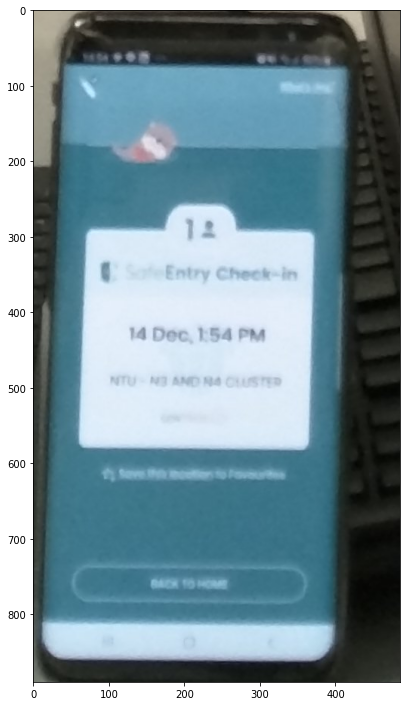

In [84]:
display_image(single_image)

In [10]:
from skimage import color, restoration
from scipy.signal import convolve2d


def unsharp_mask(image):
    blur = cv2.GaussianBlur(image, (0, 0), 3)
    return cv2.addWeighted(image, 1.5, blur, -0.5, 0)
    

def wiener_filter(rgb_img, n=7, balance=50):
    bw_image = color.rgb2gray(rgb_img)

    psf = np.ones((n, n)) / n ** 2
    bw_image = convolve2d(bw_image, psf, 'same')
    bw_image += 0.01 * bw_image.std() * np.random.standard_normal(bw_image.shape)
    deconvolved_image = restoration.wiener(bw_image, psf, balance)

    return deconvolved_image

In [11]:
single_image_enhanced = single_image

for _ in range(sharpen_rounds):
    single_image_enhanced = unsharp_mask(single_image_enhanced)

# single_image_enhanced = wiener_filter(single_image_enhanced, balance=0.01)

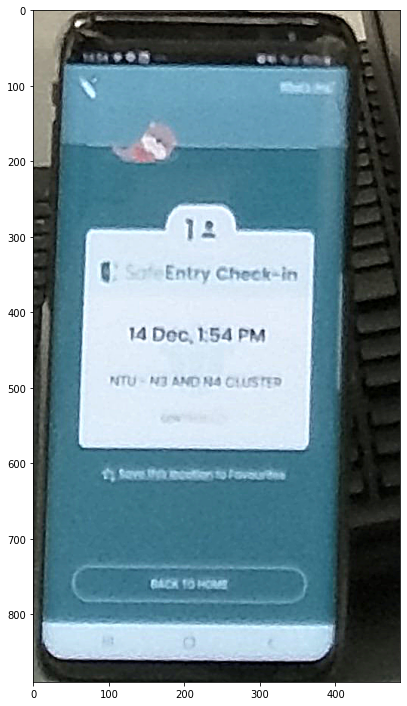

In [12]:

display_image(single_image_enhanced)

In [160]:
print(pytesseract.image_to_string(single_image_enhanced))

 

Entry Check-in

14 Dec, 54 PM

 

Tt, Seve OF BCEtN forte

GACH 15 monee



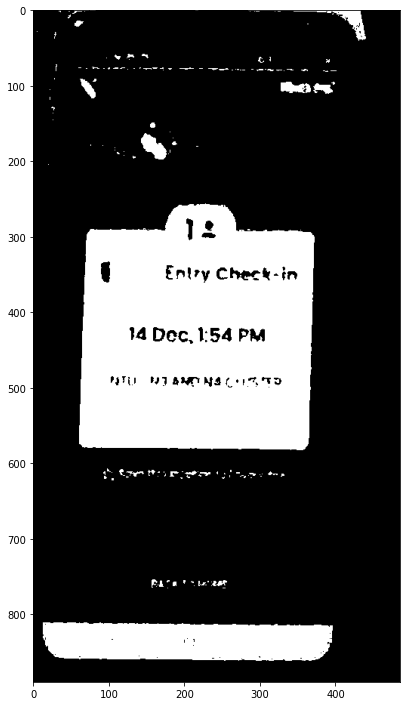

Entry Check-in

14 Dec, 1:54 PM

NTU WT AMONG CTD

 

ttre tere o

 

Rate ts teceee



In [13]:
# Thresholding, doesn't work in practice
enhanced_bw = cv2.cvtColor(single_image_enhanced, cv2.COLOR_RGB2GRAY)
_, enhanced_bw = cv2.threshold(enhanced_bw, 180, 255, cv2.THRESH_BINARY)
display_image(enhanced_bw, True)

print(pytesseract.image_to_string(enhanced_bw))


## Color Correction

In [66]:
def color_correct(img_rgb, threshold=0.5, grid_size=10):
    # Convert to Lightness, A, B model
    img_lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)

    # Perform CLAHE to the lightness component
    lab_planes = cv2.split(img_lab)
    clahe = cv2.createCLAHE(clipLimit=threshold, tileGridSize=(grid_size, grid_size))
    lab_planes[0] = clahe.apply(lab_planes[0])

    img_lab = cv2.merge(lab_planes)
    
    # Convert back to RGB
    output = cv2.cvtColor(img_lab, cv2.COLOR_LAB2RGB)
    return output


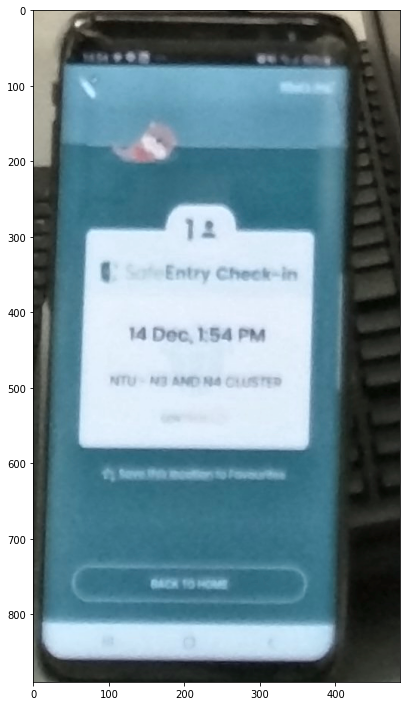

In [67]:
color_corrected = color_correct(single_image, threshold=0.5)
display_image(color_corrected)

In [114]:
def green_percentage(img_rgb, dark_green=(58, 117, 137), light_green=(114, 171, 198), diff=30):
    boundaries = [
        ([dark_green[0] - diff, dark_green[1] - diff, dark_green[2] - diff],
         [dark_green[0] + diff, dark_green[1] + diff, dark_green[2] + diff]),  # Darker green
        ([light_green[0] - diff, light_green[1] - diff, light_green[2] - diff],
         [light_green[0] + diff, light_green[1] + diff, light_green[2] + diff])  # Lighter green
    ]

    results = []
    green_count = 0

    for (lower, upper) in boundaries:
        lower = np.array(lower, dtype='uint8')
        upper = np.array(upper, dtype='uint8')

        mask = cv2.inRange(img_rgb, lower, upper)
        output = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

        results.append(output)
        green_count += cv2.countNonZero(mask)

    final = cv2.bitwise_or(results[0], results[1])

    ratio_green = green_count / (img_rgb.size / 3)

    return ratio_green, final


Green percentage: 41.64539695750682


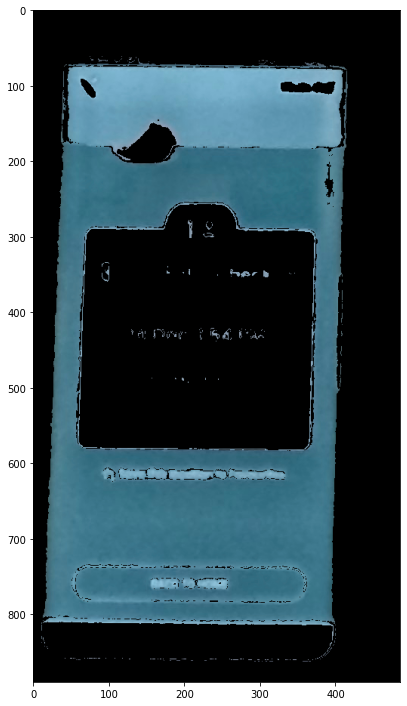

In [115]:
ratio, green_image = green_percentage(color_corrected, diff=30)
print(f'Green percentage: {ratio * 100}')
display_image(green_image)

## Multi-Image Processing

In [86]:
def get_image_paths(prefix: str, count: int, start: int = 1, format: str = 'jpg') -> list:
    result = []
    base = f'{os.curdir}/images'

    for i in range(start, start + count):
        result.append(f'{base}/{prefix} ({i}).{format}')

    return result


def imread_images(names: list) -> list:
    result = []

    for name in names:
        image = imread_image(name)

        result.append(image)

    return result


### Load the Image Set

In [97]:
set_name = 'Stationary 2'
set_length = 3

image_paths = get_image_paths(set_name, count=set_length)
images = imread_images(image_paths)

print(image_paths)

['./images/Stationary 2 (1).jpg', './images/Stationary 2 (2).jpg', './images/Stationary 2 (3).jpg']


### Display the First Image

C:\Users\Sebastian\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:19: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.


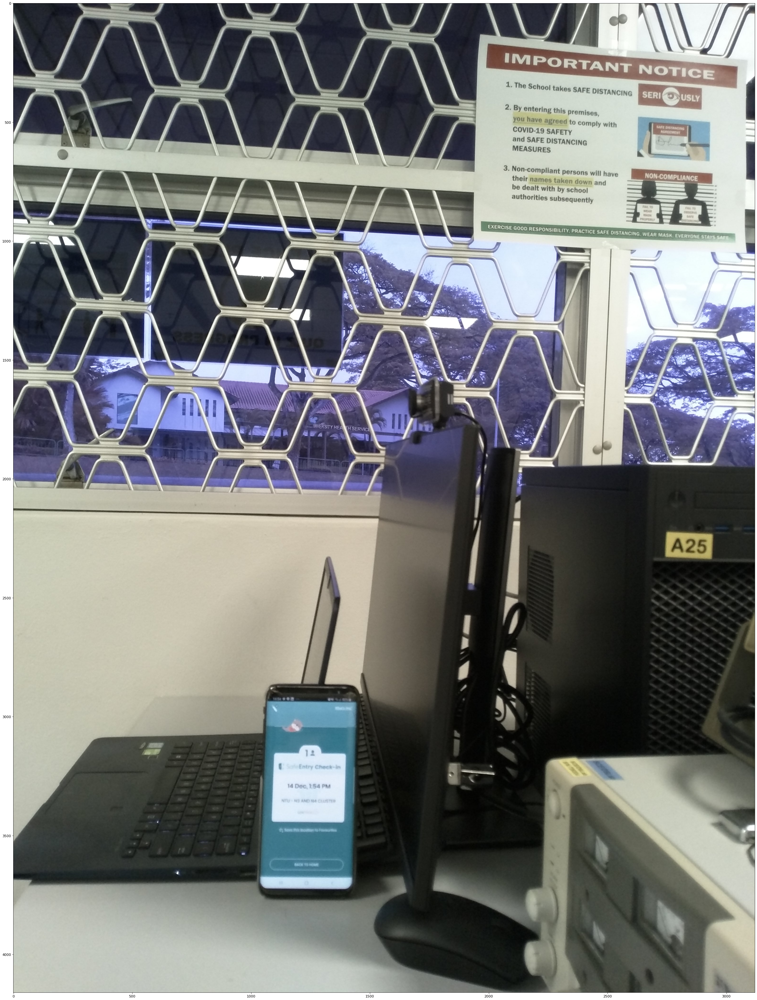

In [98]:
display_image(images[0])


In [89]:
def blend_images(images: list, alpha=1.5, beta=-0.5, gamma=0):
    if len(images) < 2:
        raise ValueError('Need at least 2 images')

    blended = images[0]

    for i in range(1, len(images)):
        blended = cv2.addWeighted(blended, alpha, images[i], beta, gamma)

    return blended


['chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'keyboard', 'chair', 'laptop', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'chair', 'laptop', 'chair', 'laptop', 'oven', 'chair', 'cell phone']


C:\Users\Sebastian\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:19: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.


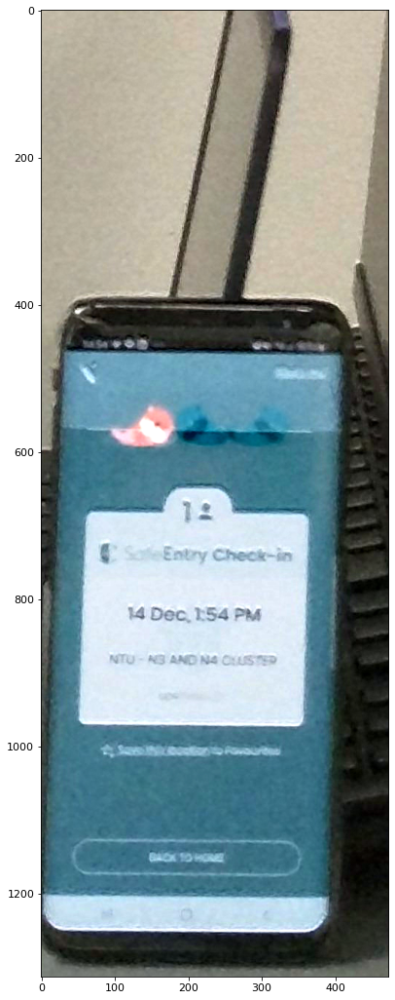

In [100]:
blended_image = blend_images(images, alpha=1.6, beta=-0.6)
blended_image = crop_mobile_phone(blended_image)
display_image(blended_image)

In [32]:
def unsharp_mask_pil(image, radius=3, percent=110, threshold=2):
    image = Image.fromarray(image)
    image = image.filter(ImageFilter.UnsharpMask(
        radius=radius, percent=percent, threshold=threshold))

    return np.array(image)

def unsharp_mask(image, rounds=3):
    img = image

    for i in range(0, rounds):
        blur = cv2.GaussianBlur(img, (0, 0), 3)
        img = cv2.addWeighted(img, 1.5, blur, -0.5, 0)
    
    return img

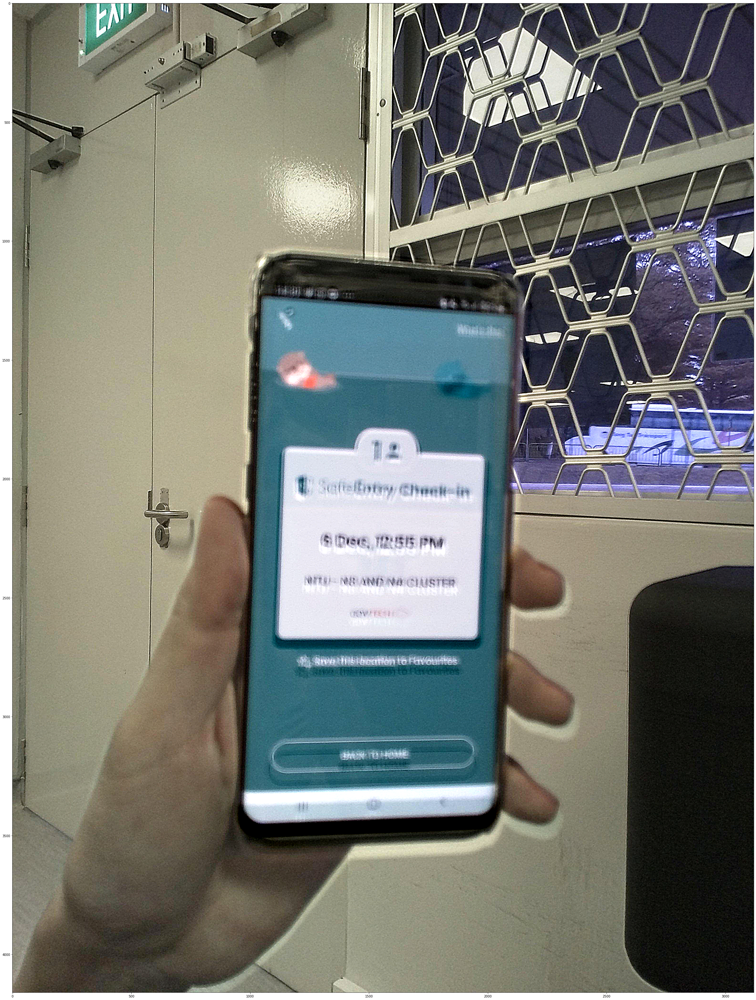

In [33]:
unsharp_cv = unsharp_mask(combined)
display_image(unsharp_cv)

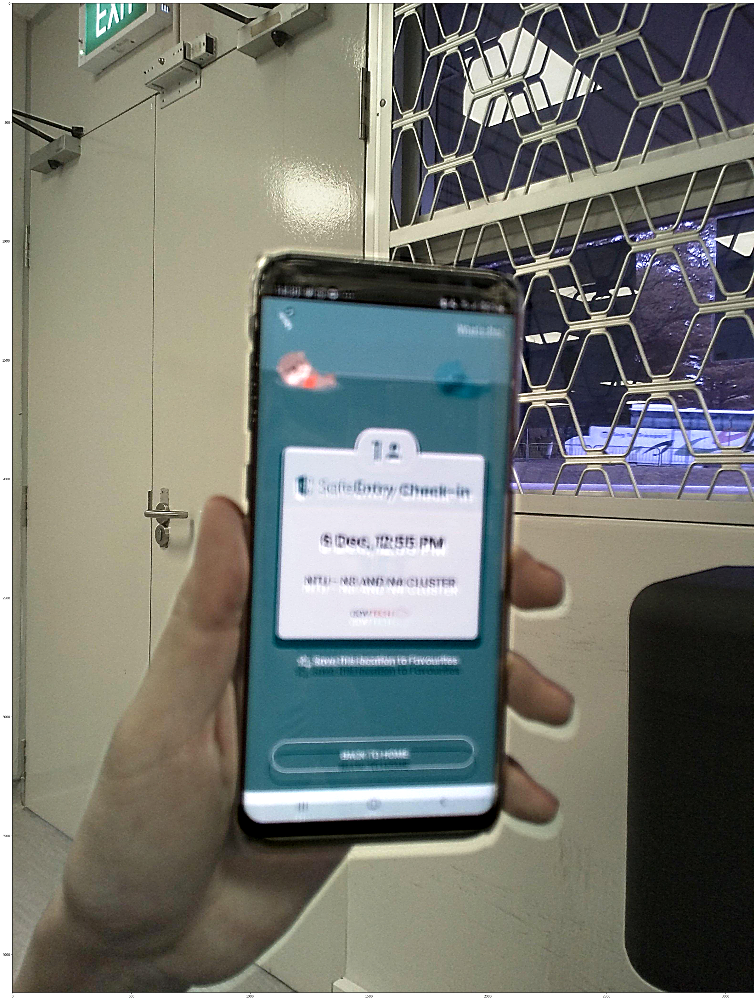

In [27]:
unsharp_pil = unsharp_mask_pil(combined, radius=5)
display_image(unsharp_pil)

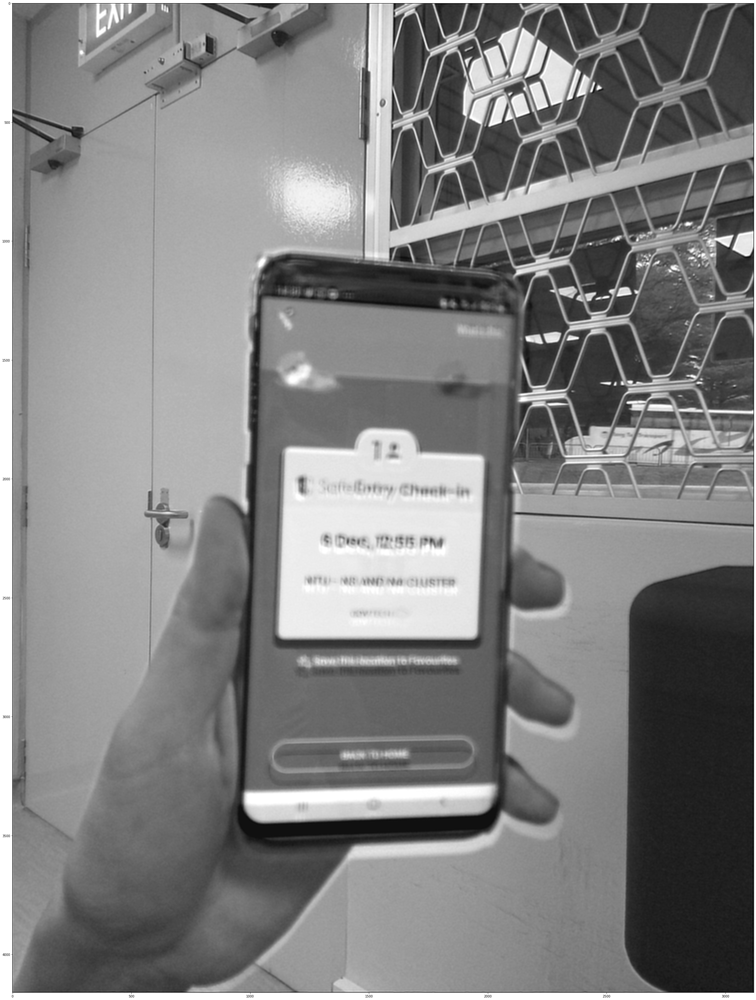

In [15]:
from skimage import color, data, restoration
from scipy.signal import convolve2d


def wiener_filter(rgb_img, n=7, balance=50):
    bw_image = color.rgb2gray(rgb_img)

    psf = np.ones((n, n)) / n ** 2
    bw_image = convolve2d(bw_image, psf, 'same')
    bw_image += 0.01 * bw_image.std() * np.random.standard_normal(bw_image.shape)
    deconvolved_image = restoration.wiener(bw_image, psf, balance)

    return deconvolved_image

display_image(wiener_filter(combined, balance=1), True)